## The Problem Statement

**The Scenario:** "Imagine you are a teacher. You have a dataset of students showing how many hours they studied and the score they received on the final exam. We want to build a model that can predict a student's score ($y$) just by looking at their study hours ($x$)."

- Input ($x$): Hours Studied.
- Target ($y$): Exam Score.

## The Setup
First, import the necessary tools for math and plotting.

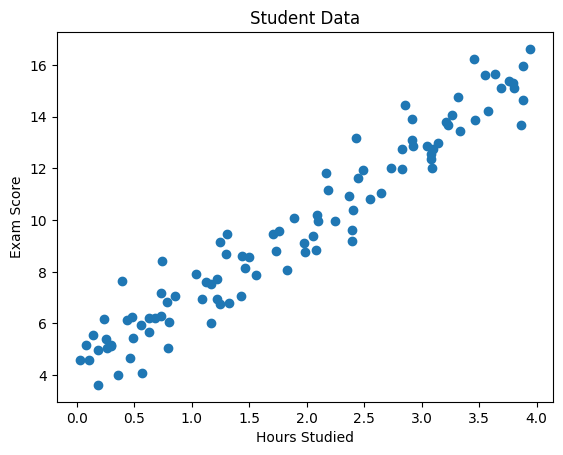

In [45]:
import numpy as np
import matplotlib.pyplot as plt

# 1. Generate Synthetic Data
# We create a simple linear relationship with some random noise
np.random.seed(42)
X = 4 * np.random.rand(100, 1) # Hours studied (0 to 4 hours)
y = 4 + 3 * X + np.random.randn(100, 1) # Exam score (y = 4 + 3x + noise)

# Visualize the data first
plt.scatter(X, y)
plt.xlabel("Hours Studied")
plt.ylabel("Exam Score")
plt.title("Student Data")
plt.show()

### Step 1: The Prediction Function (Forward Pass)
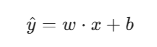

First, we need a function that takes our current weights and inputs, and draws the line. This is our hypothesis.

In [46]:
def predict(X, w, b):
    return X.dot(w) + b

### Step 2: The Cost Function (MSE)

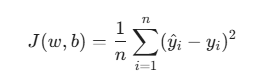

We need to measure how wrong our line is. We will use Mean Squared Error. We calculate the difference between the prediction and the actual value, square it, and average it.

In [47]:
def compute_cost(X, y, w, b):
    n_samples = len(y)
    y_pred = predict(X, w, b)
    cost = (1 / n_samples) * np.sum((y_pred - y) ** 2)
    return cost

### Step 3: Calculating Gradients

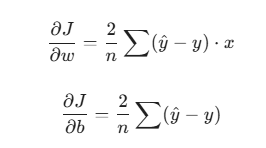

This is the most critical part. We need to find out which direction to move $w$ and $b$ to reduce the error. We use the partial derivatives we derived in the previous video.

In [48]:
def compute_gradients(X, y, w, b):
    n_samples = len(y)
    y_pred = predict(X, w, b)
    
    # Derivative with respect to weight (w)
    dw = (2 / n_samples) * X.T.dot(y_pred - y)
    
    # Derivative with respect to bias (b)
    db = (2 / n_samples) * np.sum(y_pred - y)
    
    return dw, db

### Gradient Descent Loop

Now we put it all together. We initialize random weights, and then in a loop, we predict, calculate the gradient, and update the weights.

In [65]:
def gradient_descent_with_history(X, y, learning_rate=0.1, iterations=100):
    # Initialize random parameters
    w = np.random.randn(1, 1)
    b = np.random.randn(1)
    
    # LISTS TO STORE HISTORY
    cost_history = []
    last_cost = float('inf')
    w_history = [] # Store weights at every step
    b_history = [] # NEW: Store bias at every step
    
    for i in range(iterations):
        dw, db = compute_gradients(X, y, w, b)
        
        w = w - learning_rate * dw
        b = b - learning_rate * db
        
        cost = compute_cost(X, y, w, b)

        if abs(cost-last_cost) <= 0.00001:
            print("No More traning Needed... ")
            # STORE DATA
            cost_history.append(cost)
            # VERY IMPORTANT: Use .copy() for numpy arrays!
            # Otherwise you store a reference to the changing array, not a snapshot.
            w_history.append(w.copy()) 
            b_history.append(b.copy())
            break
        
        last_cost = cost
        
        # STORE DATA
        cost_history.append(cost)
        # VERY IMPORTANT: Use .copy() for numpy arrays!
        # Otherwise you store a reference to the changing array, not a snapshot.
        w_history.append(w.copy()) 
        b_history.append(b.copy())
            
    # Return histories along with final values
    return w, b, cost_history, w_history, b_history, i

### Execution & Visualization

In [67]:
# Run the training
# Run training for slightly more iterations to see the convergence clearly
learning_rate = 0.01
iterations = 1000

final_w, final_b, cost_hist, w_hist, b_hist, final_iterations = gradient_descent_with_history(
    X, y, learning_rate, iterations
)

final_iterations+=1
print(f"Training complete! I took: {final_iterations} iterations")
print(f"Final Weights: {final_w[0][0]:.2f}")
print(f"Final Bias: {final_b[0]:.2f}")

No More traning Needed... 
Training complete! I took: 842 iterations
Final Weights: 2.91
Final Bias: 4.16


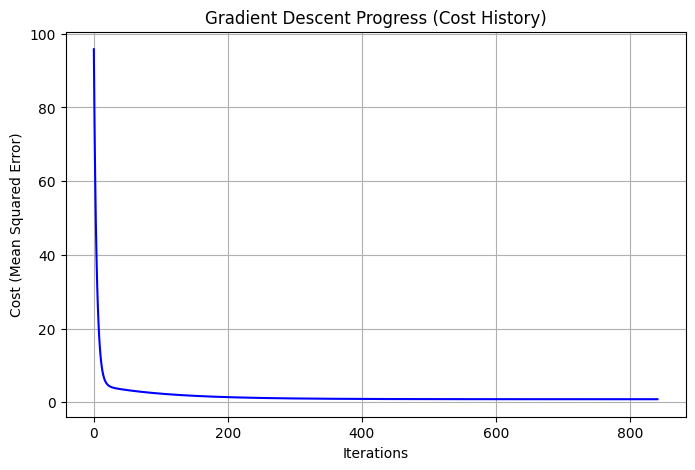

In [69]:
plt.figure(figsize=(8, 5))
plt.plot(range(final_iterations), cost_hist, 'b-')
plt.title("Gradient Descent Progress (Cost History)")
plt.xlabel("Iterations")
plt.ylabel("Cost (Mean Squared Error)")
plt.grid(True)
plt.show()

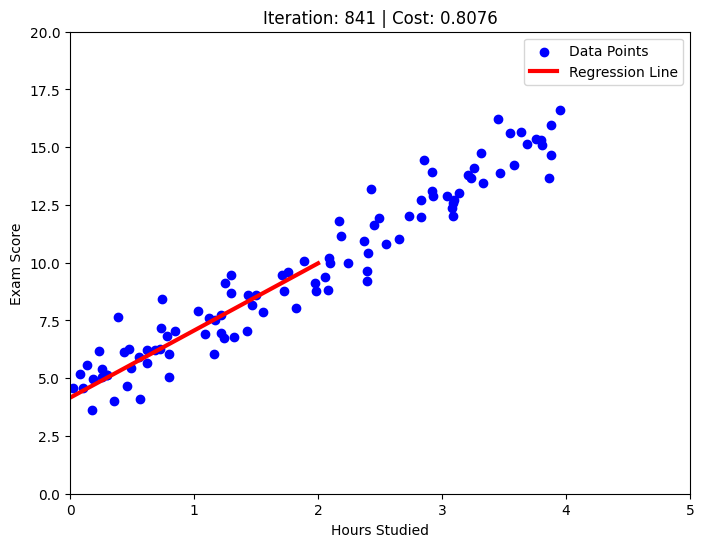

In [73]:
# Setup the figure for animation
from matplotlib.animation import FuncAnimation

fig, ax = plt.subplots(figsize=(8, 6))

# Scatter plot of the actual data (Static)
ax.scatter(X, y, color='blue', label='Data Points')

# Create a placeholder line (Empty for now)
line, = ax.plot([], [], 'r-', linewidth=3, label='Regression Line')

# Add labels and fixed limits (Crucial so axes don't jump around)
ax.set_xlim(0, 5)
ax.set_ylim(0, 20)
ax.set_xlabel("Hours Studied")
ax.set_ylabel("Exam Score")
ax.legend()
title_text = ax.set_title("")

def init():
    """Initial function to set the background of the animation."""
    line.set_data([], [])
    title_text.set_text('')
    return line, title_text

def update(frame):
    """
    This function is called for every frame of the animation.
    'frame' is the index (0, 1, 2... up to frames)
    """
    # We skip frames to make the animation faster (optional)
    # Using 'frame' directly as the index for history
    
    current_w = w_hist[frame]
    current_b = b_hist[frame]
    current_cost = cost_hist[frame]
    
    # Calculate line y-values
    # We need two points to draw a straight line: x=0 and x=2
    x_vals = np.array([[0], [2]]) 
    y_vals = x_vals * current_w + current_b
    
    line.set_data(x_vals, y_vals)
    title_text.set_text(f"Iteration: {frame} | Cost: {current_cost:.4f}")
    
    return line, title_text

anim = FuncAnimation(fig, update, init_func=init, 
                     frames=len(w_hist), interval=50, blit=True)

try:
    from IPython.display import HTML
    display(HTML(anim.to_jshtml()))
except ImportError:
    plt.show()

### Making Predictions

In [71]:
def predict_exam_score(hours, w, b):
    """
    Calculates the predicted score for a specific number of hours.
    Equation: y = w * x + b
    """
    # We access w[0][0] and b[0] to get the scalar (single number) values
    # instead of returning a numpy array.
    score = (hours * w[0][0]) + b[0]
    return score

# --- Test with a static number ---
test_hours = 5
predicted_score = predict_exam_score(test_hours, final_w, final_b)

print(f"If a student studies for {test_hours} hours,")
print(f"The model predicts a score of: {predicted_score:.2f}")

If a student studies for 5 hours,
The model predicts a score of: 18.70


### Interactive Video

In [72]:
# --- Interactive Input ---
print("\n--- LIVE PREDICTION ---")
user_input = float(input("Enter hours studied: ")) # User types here (e.g., 3.5)

result = predict_exam_score(user_input, final_w, final_b)

print(f"Predicted Score: {result:.2f}")


--- LIVE PREDICTION ---
Predicted Score: 15.79
